In [12]:
import cv2
import glob
import numpy as np
import sys
import os
import matplotlib.pyplot as plt
import subprocess
import csv

In [13]:
#garrage roof
# day_files_path = '/media/colin/box_data/ir_data/nuance_data/columbus_garrage_day_night/garrage_roof_nuance_jul17_5pm_1/cam_3/matlab_clahe2'
# day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/columbus_garrage_day_night/garrage_roof_nuance_jul17_5pm_1/cam_3/matlab_clahe2/irpoint_v5/descriptors'
# night_files_path = '/media/colin/box_data/ir_data/nuance_data/columbus_garrage_day_night/garrage_roof_nuance_jul14_7pm/cam_3/matlab_clahe2'
# night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/columbus_garrage_day_night/garrage_roof_nuance_jul14_7pm/cam_3/matlab_clahe2/irpoint_v5/descriptors'

# num results returned by bow
n_results = str(5)

#gluestick kri 
day_files_path = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2'
day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2/gluestick/matched_descriptors'
night_files_path = '/media/colin/box_data/ir_data/nuance_data/kri_night/cam_3/matlab_clahe2'
night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/kri_night/cam_3/matlab_clahe2/gluestick/matched_descriptors'
# gluestick kri reverse exp
day_files_path = '/media/colin/box_data/ir_data/nuance_data/kri_night/cam_3/matlab_clahe2'
day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/kri_night/cam_3/matlab_clahe2/gluestick/matched_descriptors'
night_files_path = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2'
night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2/gluestick/matched_descriptors'
# #gluestick carter 
day_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2'
day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2/gluestick_skip2/matched_descriptors/'
night_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2'
night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2/gluestick_skip2/matched_descriptors'

# #gluestick carter 
# day_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2'
# day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2/gluestick_skip2/matched_descriptors/'
# night_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2'
# night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2/gluestick_skip2/matched_descriptors'

#carter field sp_v6
# day_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2'
# day_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_day2/cam_3/matlab_clahe2/sp_v6/descriptors'
# night_files_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2'
# night_descriptors_path = '/media/colin/box_data/ir_data/nuance_data/cater_isec_day_night/carter_isec_alley_night/cam_3/matlab_clahe2/sp_v6/descriptors'

bow_executable = '/home/colin/Research/ir/DBoW2/build/ir_db_experiment'
temp_dir = '/home/colin/Research/ir/DBoW2/tmp'
# vocab_file = '/media/colin/box_data/ir_data/dbow2_vocabularies/irpoint_k4_L10.yml.gz'

#ok for day only
vocab_file = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2/gluestick/gluestick_voc_L5_k10.yml.gz'
#good for kri day-night
vocab_file = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2/gluestick/gluestick_day_night_voc_L5_k10.yml.gz'
vocab_file = '/media/colin/box_data/ir_data/nuance_data/kri_day_2/cam_3/matlab_clahe2/gluestick/gluestick_day_night_voc_L5_k10.yml'
#best performance
vocab_file = '/home/colin/Research/ir/DBoW2/vocs/day_night_simple_exp/gluestick_day_night_voc_kri_carter_garrage_L5_k10.yml'
#ok performance
# vocab_file = '/home/colin/Research/ir/DBoW2/vocs/day_night_simple_exp/gluestick_day_night_voc_kri_carter_garrage_L6_k10.yml.gz'

# vocab_file = '/media/colin/box_data/ir_data/dbow2_vocabularies/irpoint_k6_L10.yml.gz'
# vocab_file = '/media/colin/box_data/ir_data/dbow2_vocabularies/sp_v6_coco/voc_60k.yml.gz'
output_file = temp_dir + "/result"

# day_image_files = sorted(glob.glob(os.path.join(day_files_path,"*.png")))
# night_image_files = sorted(glob.glob(os.path.join(night_files_path,"*.png")))
# # day_descriptor_files = sorted(glob.glob(os.path.join(day_descriptors_path,"*.npy")))
# # night_descriptor_files = sorted(glob.glob(os.path.join(night_descriptors_path,"*.npy")))

# n_images_day = 500
# n_skip_day = int(len(day_image_files)/n_images_day)+1
# n_images_night = 100
# n_skip_night = int(len(night_image_files)/n_images_night)+1

# night_image_files = [f for i, f in enumerate(night_image_files) if i%n_skip_night==0]
# print("selected night {} images".format(len(night_image_files)))
# day_image_files = [f for i, f in enumerate(day_image_files) if i%n_skip_day==0]
# print("selected day {} images".format(len(day_image_files)))
# day_image_basenames = [os.path.basename(p)[:-4] for p in day_image_files]
# night_image_basenames = [os.path.basename(p)[:-4] for p in night_image_files]
# day_descriptor_files = [os.path.join(day_descriptors_path, b+".npy") for b in day_image_basenames]
# night_descriptor_files = [os.path.join(night_descriptors_path, b+".npy") for b in night_image_basenames]
# # _ = [print( os.path.isfile(p)) for p in descriptor_files]

# #write descriptor file names to temp file
# query_txt_path = os.path.join(temp_dir,"query.txt")
# with open(query_txt_path,'w') as file:
#     for d_path in night_descriptor_files[:-1]:
#         file.write(d_path + '\n')
#     file.write(night_descriptor_files[-1])

# #write descriptor file names to temp file
# db_txt_path = os.path.join(temp_dir,"db.txt")
# with open(db_txt_path,'w') as file:
#     for d_path in day_descriptor_files[:-1]:
#         file.write(d_path + '\n')
#     file.write(day_descriptor_files[-1])


def get_matching_image_and_desc_files(image_dir, desc_dir):

    all_images = sorted(glob.glob(os.path.join(image_dir,"*.png")))
    all_descriptors = sorted(glob.glob(os.path.join(desc_dir,"*.npy")))
    image_basenames = [os.path.basename(p)[:-4] for p in all_images]
    descriptor_basenames = [os.path.basename(p)[:-4] for p in all_descriptors]

    print(len(image_basenames), len(descriptor_basenames))
    matching_images = []
    matching_descriptors = []
    for i, ib in enumerate(image_basenames):
        try:
            j = descriptor_basenames.index(ib)
        except ValueError:
            continue
        matching_images.append(all_images[i])
        matching_descriptors.append(all_descriptors[j])
    return matching_images, matching_descriptors

def get_image_set(image_dir, desc_dir, n_images, all_images = False):

    image_files, descriptor_files = get_matching_image_and_desc_files(image_dir, desc_dir)
    print(len(image_files), len(descriptor_files))
    if not all_images:
        assert n_images <= len(image_files)
        increment = len(image_files)/n_images
        idxs = [int(increment*i) for i in range(n_images)]
        image_files = [image_files[i] for i in idxs]
        descriptor_files = [descriptor_files[i] for i in idxs]

    return image_files, descriptor_files

def write_paths_to_file(paths, name):
    #write descriptor file names to temp file
    with open(name,'w') as file:
        for d_path in paths[:-1]:
            file.write(d_path + '\n')
        file.write(paths[-1])

n_images_day = 500
day_image_files, day_descriptor_files = get_image_set(day_files_path, day_descriptors_path, n_images_day)
db_txt_path = os.path.join(temp_dir,"db.txt")
write_paths_to_file(day_descriptor_files, db_txt_path)
n_images_night = 100
night_image_files, night_descriptor_files = get_image_set(night_files_path, night_descriptors_path, n_images_night)
query_txt_path = os.path.join(temp_dir,"query.txt")
write_paths_to_file(night_descriptor_files, query_txt_path)


# #read images and descriptors
# query_id = 20
# # query_id = 90
# query_image_path = night_image_files[query_id]
# query_image = cv2.imread( query_image_path, cv2.IMREAD_GRAYSCALE)

query_images = [cv2.imread(i, cv2.IMREAD_GRAYSCALE) for i in night_image_files]
db_images = [cv2.imread(i, cv2.IMREAD_GRAYSCALE) for i in day_image_files]
db_descriptors = [np.load(d) for d in day_descriptor_files]

# #show images
# fig, (ax1, ax2) = plt.subplots(1,2)
# _ = ax1.imshow(query_image)
# ax1.set_title('query_image')
# _ = ax2.imshow(images[query_id])
# ax2.set_title('closest_image')

# print(os.path.basename(offset_image_files[query_id])[:-4])
# print(os.path.basename((image_files[query_id]))[:-4])

16557 8278
8278 8278
13068 6533
6533 6533


In [14]:
cmd = [bow_executable, query_txt_path, db_txt_path, vocab_file, output_file, n_results]
# print(" ".join(cmd))

process = subprocess.Popen(cmd)
result_status = process.wait()
assert result_status == 0

reading files from:
/home/colin/Research/ir/DBoW2/tmp/db.txt
Reading file names from: '/home/colin/Research/ir/DBoW2/tmp/db.txt'
Found 500 descriptor files
reading files from:
/home/colin/Research/ir/DBoW2/tmp/query.txt
Reading file names from: '/home/colin/Research/ir/DBoW2/tmp/query.txt'
Found 100 descriptor files
loading feature set 1...
features loaded in 0.264724 seconds
loading feature set 2...
features loaded in 1.02769 seconds
running voc test...
reading in voc file : /home/colin/Research/ir/DBoW2/vocs/day_night_simple_exp/gluestick_day_night_voc_kri_carter_garrage_L5_k10.yml
TemplatedVocabulary::load -- initializing cv::FileStorage : /home/colin/Research/ir/DBoW2/vocs/day_night_simple_exp/gluestick_day_night_voc_kri_carter_garrage_L5_k10.yml
TemplatedVocabulary::load -- initialized cv::FileStorage
TemplatedVocabulary::load -- initializing calling load(fs)
TemplatedVocabulary.load--loading vocabulary...
TemplatedVocabulary.load--init filenode...
TemplatedVocabulary.load-- creat

In [15]:
# for i in range(len(night_image_files)):
#     #read results
#     results = []
#     with open(output_file + str(i), 'r') as csv_file:
#         reader = csv.reader(csv_file, delimiter = ',')
#         for row in reader:
#             results.append([int(row[0]), float(row[1])])

#     #show results
#     fig, axes = plt.subplots(1,len(results)+1, figsize = (20,60))
#     axes[0].imshow(query_images[i])
#     axes[0].set_title("Query Image : {}".format(i))
#     axes[0].axis('off')
#     for i, res in enumerate(results):
#         idx = res[0]
#         score = res[1]
#         result_image = db_images[idx]
#         i = i +1
#         axes[i].imshow(result_image)
#         axes[i].set_title("score = {}".format(score))
#         axes[i].axis('off')

Geometric verification took 19.36104917526245 seconds
Found 96 loop closures for 100 image querries in db with 500 images


/tmp/ipykernel_1631635/1620475676.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1,int(n_results)+1, figsize = (20,3))


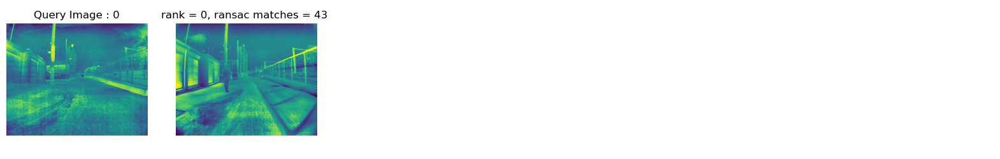

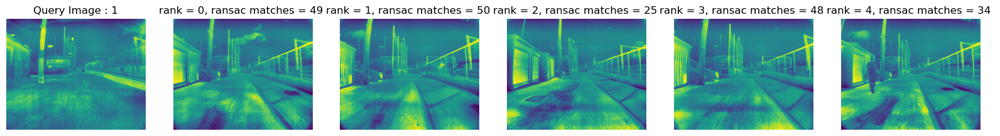

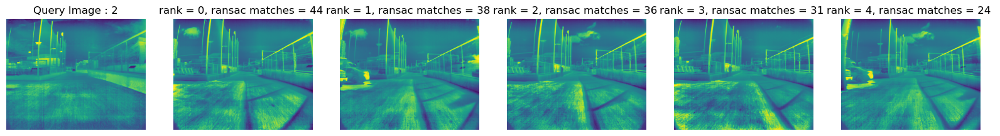

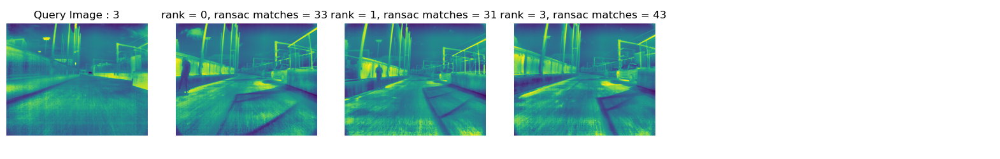

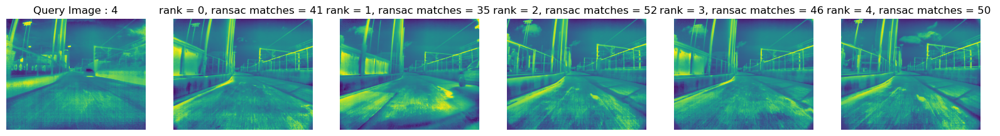

...

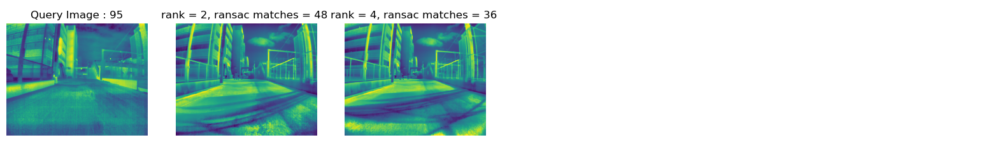

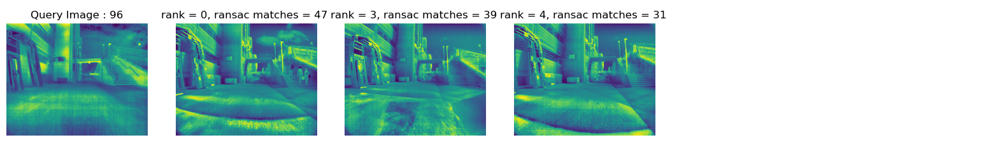

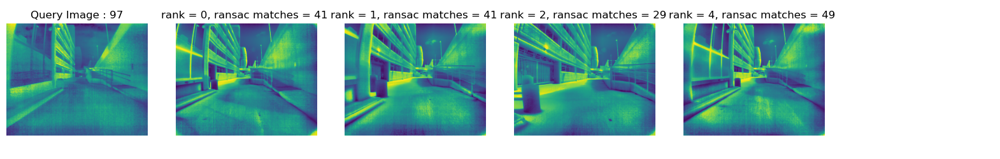

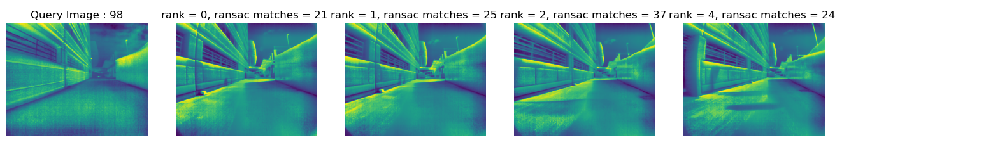

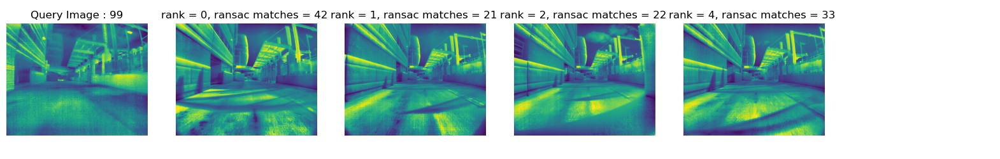

In [16]:
'''Attempt to filter out false loop closure candidates'''

from util.geometric_verification import match_confidence
import time
geometric_match_threshold = 25

start_time = time.time()
summary_results = []
positive_results = np.zeros(len(night_image_files), dtype = int)
for i in range(len(night_image_files)):
    query_image = query_images[i]
    
    #read results
    results = []
    with open(output_file + str(i), 'r') as csv_file:
        reader = csv.reader(csv_file, delimiter = ',')
        for row in reader:
            results.append([int(row[0]), float(row[1])])

    #show results
    querry_descriptor_file = night_descriptor_files[i]
    result_images = []
    result_ranks = []
    result_scores = []
    for j, res in enumerate(results):
        idx = res[0]
        score = res[1]
        result_image = db_images[idx]
        db_descriptor_file = day_descriptor_files[idx]
        geometric_result = match_confidence(querry_descriptor_file, db_descriptor_file)
        if geometric_result > geometric_match_threshold:
            positive_results[i] = 1
            result_images.append(result_image)
            result_ranks.append(j)
            result_scores.append(geometric_result) 
    summary_results.append((query_image, result_images, result_ranks, result_scores))
#summary
end_time = time.time()
print("Geometric verification took {} seconds".format(end_time-start_time))
print("Found {} loop closures for {} image querries in db with {} images".format(positive_results.sum(), len(positive_results), len(db_images)))

for i, result_pack in enumerate(summary_results):
    query_image, result_images, result_ranks, result_scores = result_pack[0], result_pack[1], result_pack[2], result_pack[3]

    #show results
    fig, axes = plt.subplots(1,int(n_results)+1, figsize = (20,3))
    axes[0].imshow(query_image)
    axes[0].set_title("Query Image : {}".format(i))
    axes[0].axis('off')
    for j, result_image, result_rank, result_score in zip(range(len(result_images)), result_images, result_ranks, result_scores):
        geometric_result_str = "rank = {}, ransac matches = {} ".format(result_rank, result_score)
        # geometric_result_str = "Passed Geometric Check" if geometric_result else "Failed Geometric Check"
        j = j +1
        axes[j].imshow(result_image)
        axes[j].set_title(geometric_result_str)
    _ = [ax.axis('off') for ax in axes]
    
